In [1]:
import os
import json
import pandas as pd
import numpy as np
import lda
from sklearn.cross_validation import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.cross_validation import KFold
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB

from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
stop = set(stopwords.words('english'))
from string import punctuation
from collections import Counter
import re
import requests
from datetime import datetime
#from tqdm import tqdm
from matplotlib import pyplot as plt
%matplotlib inline
pd.options.mode.chained_assignment = None

/home/ubuntu/anaconda3/lib/python3.6/site-packages/sklearn/cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
cred_fp = '/ebs_volume/data/Credible/'
ncred_fp = '/ebs_volume/data/notCredible/'

In [3]:
articles = pd.DataFrame(columns=('label',
                                 'text',
                                 'title',
                                 'date',
                                 'source',
                                 'images',
                                 'videos',
                                 'url'))
i = 0    
for root, dirs, files in os.walk(cred_fp):
    for file in files:
        if file.endswith(".txt") and 'api' not in file:
             curr_file = os.path.join(root, file)
             #print curr_file
             with open(curr_file) as json_file:
                try:
                    data = json.load(json_file)
                    articles.loc[i] = [0,data["text"],data["title"],data["date"],data["source"],data["images"],data["videos"],data["url"]]
                    i+=1
                except ValueError:
                    continue

for root, dirs, files in os.walk(ncred_fp):
    for file in files:
        if file.endswith(".txt") and 'api' not in file:
             curr_file = os.path.join(root, file)
             #print curr_file
             with open(curr_file) as json_file:
                try:
                    data = json.load(json_file)
                    articles.loc[i] = [1,data["text"],data["title"],data["date"],data["source"],data["images"],data["videos"],data["url"]]
                    i+=1
                except ValueError:
                    continue

In [4]:
train, test = train_test_split(articles, test_size = 0.2)
print("train data shape:", train.shape)
print("test data shape:", test.shape)

train data shape: (3311, 8)
test data shape: (828, 8)


In [5]:
len(articles[articles["label"]==1.])

3228

In [6]:
len(articles[articles["label"]==0.])

911

In [7]:
articles.head()

,label,text,title,date,source,images,videos,url
0,0.0,View Images An uncrewed Dragon capsule makes t...,SpaceX Plans to Send People to the Moon in 201...,02-28-2017,national-geographic,[http://news.nationalgeographic.com/etc/design...,[https://www.youtube.com/embed/VJxvExL0pU4],http://news.nationalgeographic.com/2017/02/spa...
1,0.0,Watch: Impatient Elephant Disobeys Railway Rul...,Watch a Young Elephant Make a Surprising Railr...,02-28-2017,national-geographic,[http://pmdvod.nationalgeographic.com/NG_Video...,[],http://news.nationalgeographic.com/2017/02/ele...
2,0.0,View Images An advanced laser imaging techniqu...,This May Be Our Best Idea of What a Dinosaur R...,02-28-2017,national-geographic,[http://news.nationalgeographic.com/etc/design...,[],http://news.nationalgeographic.com/2017/02/anc...
3,0.0,WATCH: Visitors at Badaling Wildlife Park brea...,Bear Attacks Car In Chinese Zoo Famous For Tig...,02-28-2017,national-geographic,[http://pmdvod.nationalgeographic.com/NG_Video...,[https://www.youtube.com/embed/9xNzNqq-0n0?rel=0],http://news.nationalgeographic.com/2017/02/bea...
4,0.0,View Images Participants at the Slav and Vikin...,How to Eat Like a Viking,02-28-2017,national-geographic,[http://news.nationalgeographic.com/content/da...,[https://www.youtube.com/embed/oNEW4qPacGw],http://news.nationalgeographic.com/2017/02/eat...


In [8]:

print('articles shape:', articles.shape)

# remove duplicate description columns
articles = articles.drop_duplicates('text')
# remove rows with empty descriptions
articles = articles[~articles['text'].isnull()]
print('articles shape:', articles.shape)
articles['len'] = articles['text'].map(len)

articles = articles[articles.len > 140]
articles.reset_index(inplace=True)
articles.drop('index', inplace=True, axis=1)
print('articles shape:', articles.shape)

articles shape: (4139, 8)
articles shape: (3236, 8)
articles shape: (3124, 9)


In [9]:


#break the descriptions into sentences and then break the sentences into tokens
#remove punctuation and stop words
#lowercase the tokens
def tokenizer(text):
    try:
        tokens_ = [word_tokenize(sent) for sent in sent_tokenize(text)]
        
        tokens = []
        for token_by_sent in tokens_:
            tokens += token_by_sent

        tokens = list(filter(lambda t: t.lower() not in stop, tokens))
        tokens = list(filter(lambda t: t not in punctuation, tokens))
        tokens = list(filter(lambda t: t not in [u"'s", u"n't", u"...", u"''", u'``', 
                                            u'\u2014', u'\u2026', u'\u2013'], tokens))
        filtered_tokens = []
        for token in tokens:
            if re.search('[a-zA-Z]', token):
                filtered_tokens.append(token)

        filtered_tokens = list(map(lambda token: token.lower(), filtered_tokens))

        return filtered_tokens
    except Error as e:
        print(e)

In [10]:
articles['tokens'] = articles['text'].map(tokenizer)

In [11]:
for text, tokens in zip(articles['text'].head(5), articles['tokens'].head(5)):
    print('text:', text)
    print('tokens:', tokens)
    print() 

text: View Images An uncrewed Dragon capsule makes the journey to the International Space Station. The human-ready version has yet to fly in space.

Photograph by NASA

In a surprising and somewhat secretive press briefing, Elon Musk announced today that his company SpaceX intends to fly two paying passengers to the moon by late 2018. The pair reportedly approached SpaceX with the idea and have paid the company a “significant deposit.”

As envisioned, the mission would lift off from Pad 39A at NASA’s Kennedy Space Center in Cape Canaveral, Florida—the same launch pad from which the Apollo missions blasted off more than four decades ago, delivering astronauts into lunar orbit and onto the moon’s surface. The SpaceX passengers wouldn’t walk on the moon, though; the trip would slingshot them around the moon before returning to Earth.

“This presents an opportunity for humans to return to deep space for the first time in 45 years and they will travel faster and further into the Solar Syste

In [12]:
def keywords(source):
    tokens = articles[articles['source'] == source]['tokens']
    alltokens = []
    for token_list in tokens:
        alltokens += token_list
    counter = Counter(alltokens)
    return counter.most_common(10)

In [13]:
for source in set(articles['source']):
    print('source :', source)
    print('top 10 keywords:', keywords(source))
    print('---')

source : usanewsflash
top 10 keywords: [('trump', 951), ('president', 717), ('obama', 271), ('said', 257), ('people', 223), ('one', 218), ('first', 199), ('trump’s', 181), ('us', 173), ('news', 171)]
---
source : usfanzone
top 10 keywords: [('trump', 150), ('comments', 145), ('said', 134), ('president', 94), ('people', 90), ('one', 58), ('it’s', 48), ('new', 46), ('think', 44), ('media', 44)]
---
source : usa-today
top 10 keywords: [('trump', 984), ('said', 861), ('skip', 853), ('x', 848), ('share', 545), ('president', 496), ('close', 445), ('embed', 424), ('house', 271), ('first', 261)]
---
source : the-new-york-times
top 10 keywords: [('mr.', 1064), ('said', 754), ('story', 622), ('continue', 604), ('main', 592), ('reading', 591), ('advertisement', 588), ('trump', 455), ('would', 317), ('new', 313)]
---
source : activistpost
top 10 keywords: [('would', 547), ('government', 505), ('one', 492), ('us', 485), ('state', 444), ('also', 435), ('new', 434), ('people', 418), ('cia', 418), ('w

In [14]:
from sklearn.feature_extraction.text import TfidfVectorizer

# min_df is minimum number of documents that contain a term t
# max_features is maximum number of unique tokens (across documents) that we'd consider
# TfidfVectorizer preprocesses the descriptions using the tokenizer we defined above

vectorizer = TfidfVectorizer(min_df=10, max_features=10000, tokenizer=tokenizer, ngram_range=(1, 2))
vz = vectorizer.fit_transform(list(articles['text']))

In [15]:
vz.shape

(3124, 10000)

In [16]:
tfidf = dict(zip(vectorizer.get_feature_names(), vectorizer.idf_))
tfidf = pd.DataFrame(columns=['tfidf']).from_dict(dict(tfidf), orient='index')
tfidf.columns = ['tfidf']

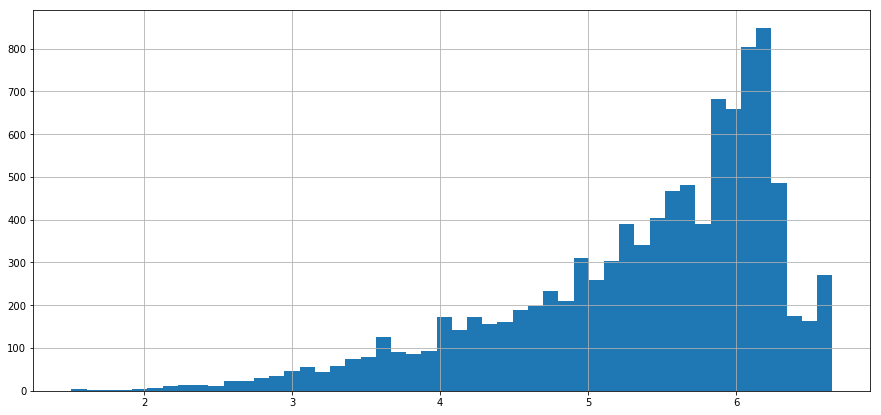

In [17]:
tfidf.tfidf.hist(bins=50, figsize=(15,7))

In [18]:
tfidf.sort_values(by=['tfidf'], ascending=True).head(30)

,tfidf
trump,1.509760
president,1.522089
said,1.522628
one,1.570151
people,1.643519
also,1.646569
would,1.668181
time,1.803677
new,1.864078
like,1.870935


In [19]:
tfidf.sort_values(by=['tfidf'], ascending=False).head(30)

,tfidf
waivers,6.649294
maxine waters,6.649294
firefighters,6.649294
historically black,6.649294
morris,6.649294
spark,6.649294
carrying race,6.649294
hill washington,6.649294
libyan,6.649294
jack burns,6.649294


In [20]:
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD(n_components=50, random_state=0)
svd_tfidf = svd.fit_transform(vz)

In [21]:
svd_tfidf.shape

(3124, 50)

In [22]:
from sklearn.manifold import TSNE

tsne_model = TSNE(n_components=2, verbose=1, random_state=0)
tsne_tfidf = tsne_model.fit_transform(svd_tfidf)

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 3124
[t-SNE] Computed conditional probabilities for sample 2000 / 3124
[t-SNE] Computed conditional probabilities for sample 3000 / 3124
[t-SNE] Computed conditional probabilities for sample 3124 / 3124
[t-SNE] Mean sigma: 0.105057
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.329451
[t-SNE] Error after 275 iterations: 1.329451


In [23]:
tsne_tfidf.shape
tsne_tfidf

array([[  9.45481043,  10.30378895],
       [  9.15593006,  11.82289233],
       [  8.26075997,  12.60336409],
       ..., 
       [  4.10569922,  -0.54487459],
       [  6.45455917,   2.39944628],
       [ 11.30967198,   3.61599632]])

In [24]:
import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.plotting import figure, show, output_notebook

In [25]:
output_notebook()
plot_tfidf = bp.figure(plot_width=700, plot_height=600, title="tf-idf clustering of the news",
    tools="pan,wheel_zoom,box_zoom,reset,hover,previewsave",
    x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [26]:
tfidf_df = pd.DataFrame(tsne_tfidf, columns=['x', 'y'])
tfidf_df['text'] = articles['text']
tfidf_df['source'] = articles['source']

In [27]:
plot_tfidf.scatter(x='x', y='y', source=tfidf_df)
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"text": "@text", "source":"@source"}
show(plot_tfidf)

In [28]:
vz.shape

(3124, 10000)

In [29]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

from sklearn.cluster import MiniBatchKMeans

num_clusters = 30
kmeans_model = MiniBatchKMeans(n_clusters=num_clusters, init='k-means++', n_init=1, 
                         init_size=1000, batch_size=1000, verbose=False, max_iter=1000)
kmeans = kmeans_model.fit(vz)
kmeans_clusters = kmeans.predict(vz)
kmeans_distances = kmeans.transform(vz)

In [30]:
for (i, desc),source in zip(enumerate(articles.text),articles['source']):
    if(i < 5):
        print("Cluster " + str(kmeans_clusters[i]) + ": " + desc + 
              "(distance: " + str(kmeans_distances[i][kmeans_clusters[i]]) + ")")
        print('source: ',source)
        print('---')

Cluster 28: View Images An uncrewed Dragon capsule makes the journey to the International Space Station. The human-ready version has yet to fly in space.

Photograph by NASA

In a surprising and somewhat secretive press briefing, Elon Musk announced today that his company SpaceX intends to fly two paying passengers to the moon by late 2018. The pair reportedly approached SpaceX with the idea and have paid the company a “significant deposit.”

As envisioned, the mission would lift off from Pad 39A at NASA’s Kennedy Space Center in Cape Canaveral, Florida—the same launch pad from which the Apollo missions blasted off more than four decades ago, delivering astronauts into lunar orbit and onto the moon’s surface. The SpaceX passengers wouldn’t walk on the moon, though; the trip would slingshot them around the moon before returning to Earth.

“This presents an opportunity for humans to return to deep space for the first time in 45 years and they will travel faster and further into the Solar

In [31]:
sorted_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()
for i in range(num_clusters):
    print("Cluster %d:" % i)
    aux = ''
    for j in sorted_centroids[i, :10]:
        aux += terms[j] + ' | '
    print(aux)
    print() 

Cluster 0:
mr. | mr. trump | rockefeller | trump | mr. trump’s | president | trump’s | said | donald | david | 

Cluster 1:
secret service | secret | service | fence | white house | house | white | tran | security | president | 

Cluster 2:
cnn | fake | news | fake news | media | trump | times | president | people | network | 

Cluster 3:
trump | obama | president | fbi | comey | intelligence | house | said | russian | white house | 

Cluster 4:
image | caption | image caption | image copyright | copyright | said | police | mr | bridge | london | 

Cluster 5:
sessions | russian | ambassador | russian ambassador | trump | jeff | attorney | pelosi | jeff sessions | attorney general | 

Cluster 6:
ban | travel | order | travel ban | judge | hawaii | executive order | court | executive | trump | 

Cluster 7:
eu | brexit | uk | march | per cent | cent | getty | said | mr | britain | 

Cluster 8:
melania | first lady | lady | melania trump | first | trump | michelle | prayer | white house | 

In [32]:
tsne_kmeans = tsne_model.fit_transform(kmeans_distances)

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 3124
[t-SNE] Computed conditional probabilities for sample 2000 / 3124
[t-SNE] Computed conditional probabilities for sample 3000 / 3124
[t-SNE] Computed conditional probabilities for sample 3124 / 3124
[t-SNE] Mean sigma: 0.022532
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.347085
[t-SNE] Error after 350 iterations: 1.347085


In [33]:
import numpy as np

colormap = np.array(["#6d8dca", "#69de53", "#723bca", "#c3e14c", "#c84dc9", "#68af4e", "#6e6cd5",
"#e3be38", "#4e2d7c", "#5fdfa8", "#d34690", "#3f6d31", "#d44427", "#7fcdd8", "#cb4053", "#5e9981",
"#803a62", "#9b9e39", "#c88cca", "#e1c37b", "#34223b", "#bdd8a3", "#6e3326", "#cfbdce", "#d07d3c",
"#52697d", "#7d6d33", "#d27c88", "#36422b", "#b68f79"])

plot_kmeans = bp.figure(plot_width=700, plot_height=600, title="KMeans clustering of the news",
    tools="pan,wheel_zoom,box_zoom,reset,hover,previewsave",
    x_axis_type=None, y_axis_type=None, min_border=1)



In [34]:
kmeans_df = pd.DataFrame(tsne_kmeans, columns=['x', 'y'])
kmeans_df['cluster'] = kmeans_clusters
kmeans_df['text'] = articles['text']
kmeans_df['source'] = articles['source']

In [35]:
plot_kmeans.scatter(x='x', y='y', 
                    color=colormap[kmeans_clusters], 
                    source=kmeans_df)
hover = plot_kmeans.select(dict(type=HoverTool))
hover.tooltips={"text": "@text", "source": "@source", "cluster":"@cluster"}
show(plot_kmeans)

In [38]:
from sklearn.feature_extraction.text import CountVectorizer
import logging
logging.getLogger("lda").setLevel(logging.WARNING)

In [39]:
cvectorizer = CountVectorizer(min_df=4, max_features=10000, tokenizer=tokenizer, ngram_range=(1,2))
cvz = cvectorizer.fit_transform(articles['text'])

n_topics = 20
n_iter = 2000
lda_model = lda.LDA(n_topics=n_topics, n_iter=n_iter)
X_topics = lda_model.fit_transform(cvz)



In [40]:
n_top_words = 8
topic_summaries = []

topic_word = lda_model.topic_word_  # get the topic words
vocab = cvectorizer.get_feature_names()
for i, topic_dist in enumerate(topic_word):
    topic_words = np.array(vocab)[np.argsort(topic_dist)][:-(n_top_words+1):-1]
    topic_summaries.append(' '.join(topic_words))
    print('Topic {}: {}'.format(i, ' '.join(topic_words)))

Topic 0: said police man two told service one attack
Topic 1: house said would bill republicans health obamacare republican
Topic 2: skip x share close close skip embed x share embed x
Topic 3: cia information intelligence wikileaks clinton security documents hillary
Topic 4: people would like one get it’s know even
Topic 5: trump obama president said russian house campaign sessions
Topic 6: obama government state us political world power states
Topic 7: trump president president trump donald white donald trump trump’s first
Topic 8: order immigration states ban united court united states executive
Topic 9: says water climate new change national world one
Topic 10: vaccines catherine health smart available book vaccine cancer
Topic 11: mr. story reading main continue advertisement continue reading advertisement continue
Topic 12: tax budget million money said federal government percent
Topic 13: media news fake press cnn mainstream post fake news
Topic 14: said mr image march minister 

In [41]:
tsne_lda = tsne_model.fit_transform(X_topics)

[t-SNE] Computing pairwise distances...
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Computed conditional probabilities for sample 1000 / 3124
[t-SNE] Computed conditional probabilities for sample 2000 / 3124
[t-SNE] Computed conditional probabilities for sample 3000 / 3124
[t-SNE] Computed conditional probabilities for sample 3124 / 3124
[t-SNE] Mean sigma: 0.107310
[t-SNE] KL divergence after 100 iterations with early exaggeration: 1.400948
[t-SNE] Error after 300 iterations: 1.400948


In [42]:
doc_topic = lda_model.doc_topic_
lda_keys = []
for i, tweet in enumerate(articles['text']):
    lda_keys += [doc_topic[i].argmax()]

In [43]:
plot_lda = bp.figure(plot_width=700, plot_height=600, title="LDA topic visualization",
    tools="pan,wheel_zoom,box_zoom,reset,hover,previewsave",
    x_axis_type=None, y_axis_type=None, min_border=1)

In [44]:
lda_df = pd.DataFrame(tsne_lda, columns=['x','y'])
lda_df['text'] = articles['text']
lda_df['source'] = articles['source']

In [45]:
lda_df['source'] = lda_keys
lda_df['source'] = lda_df['source'].map(int)

In [46]:
plot_lda.scatter(source=lda_df, x='x', y='y', color=colormap[lda_keys])

hover = plot_lda.select(dict(type=HoverTool))
hover.tooltips={"text":"@text", "topic":"@topic", "source":"@source"}
show(plot_lda)


In [60]:
lda_df['len_docs'] = articles['tokens'].map(len)

In [61]:
def prepareLDAData():
    data = {
        'vocab': vocab,
        'doc_topic_dists': lda_model.doc_topic_,
        'doc_lengths': list(lda_df['len_docs']),
        'term_frequency':cvectorizer.vocabulary_,
        'topic_term_dists': lda_model.components_
    } 
    return data

In [62]:
ldadata = prepareLDAData()

In [63]:
import pyLDAvis

In [64]:
pyLDAvis.enable_notebook()

In [65]:
prepared_data = pyLDAvis.prepare(**ldadata)

In [66]:
pyLDAvis.save_html(prepared_data,'./pyldadavis.html')

In [59]:
!conda install bokeh

Fetching package metadata .........
Solving package specifications: .

Package plan for installation in environment /home/ubuntu/anaconda3:

The following packages will be UPDATED:

    conda: 4.3.8-py36_0 --> 4.3.14-py36_0

Proceed ([y]/n)? ^C


CondaSignalInterrupt: Signal interrupt SIGINT




/bin/sh: 1: y: not found
